# Project Time Series Workflowsplit the data, feature engineer the data and modeling


---

## 0) Imports

In [1]:
import pandas as pd
import numpy as np
from sklearn.linear_model import LinearRegression
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import statsmodels as sm
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from statsmodels.tsa.ar_model import AutoReg
# from statsmodels.tsa.ar_model import AutoReg

#from cleanup import clean_data
#from engineer import feature_engineer

## 1) Define the Business Goal

Build a model that can predict tomorrow's temperature as precisely as possible.

Feel free to define your own business goal on top of the existing ones.

## 2) Get the Data

### 2.1) Load the Data

In [2]:
df = pd.read_csv('tem.txt', sep=",", header=14, skipinitialspace=True, index_col=[1], parse_dates=True)
df.columns


Index(['SOUID', 'TG', 'Q_TG'], dtype='object')

In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 53691 entries, 1876-01-01 to 2022-12-31
Data columns (total 3 columns):
 #   Column  Non-Null Count  Dtype
---  ------  --------------  -----
 0   SOUID   53691 non-null  int64
 1   TG      53691 non-null  int64
 2   Q_TG    53691 non-null  int64
dtypes: int64(3)
memory usage: 1.6 MB


In [4]:
df.describe()

,SOUID,TG,Q_TG
count,53691.000000,53691.000000,53691.000000
mean,119308.449312,57.461101,0.032687
std,8022.969883,612.236976,0.541406
min,111448.000000,-9999.000000,0.000000
25%,111448.000000,33.000000,0.000000
50%,111448.000000,94.000000,0.000000
75%,127488.000000,157.000000,0.000000
max,128124.000000,305.000000,9.000000


### 2.2) Clean the Data

In [5]:
df.isnull().sum()

SOUID    0
TG       0
Q_TG     0
dtype: int64

In [6]:
df.duplicated().sum()

52574

In [7]:
df = df.dropna()
df


,SOUID,TG,Q_TG
DATE,,,
1876-01-01,127488,22,0
1876-01-02,127488,25,0
1876-01-03,127488,3,0
1876-01-04,127488,-58,0
1876-01-05,127488,-98,0
...,...,...,...
2022-12-27,111448,42,0
2022-12-28,111448,63,0
2022-12-29,111448,100,0


In [8]:
df.replace(regex=r'^ba.$\n', value='new')
df

,SOUID,TG,Q_TG
DATE,,,
1876-01-01,127488,22,0
1876-01-02,127488,25,0
1876-01-03,127488,3,0
1876-01-04,127488,-58,0
1876-01-05,127488,-98,0
...,...,...,...
2022-12-27,111448,42,0
2022-12-28,111448,63,0
2022-12-29,111448,100,0


In [9]:
df.drop_duplicates()


,SOUID,TG,Q_TG
DATE,,,
1876-01-01,127488,22,0
1876-01-02,127488,25,0
1876-01-03,127488,3,0
1876-01-04,127488,-58,0
1876-01-05,127488,-98,0
...,...,...,...
2015-07-04,111448,301,0
2018-07-31,111448,288,0
2020-08-08,111448,285,0


In [10]:
df.drop(df.columns[[0, 2]], axis=1, inplace=True)
df.head()

,TG
DATE,
1876-01-01,22
1876-01-02,25
1876-01-03,3
1876-01-04,-58
1876-01-05,-98


In [11]:
#df['TG'].unique
df.loc[:,'TG'] *= 0.1
df

,TG
DATE,
1876-01-01,2.2
1876-01-02,2.5
1876-01-03,0.3
1876-01-04,-5.8
1876-01-05,-9.8
...,...
2022-12-27,4.2
2022-12-28,6.3
2022-12-29,10.0


<AxesSubplot: xlabel='DATE'>

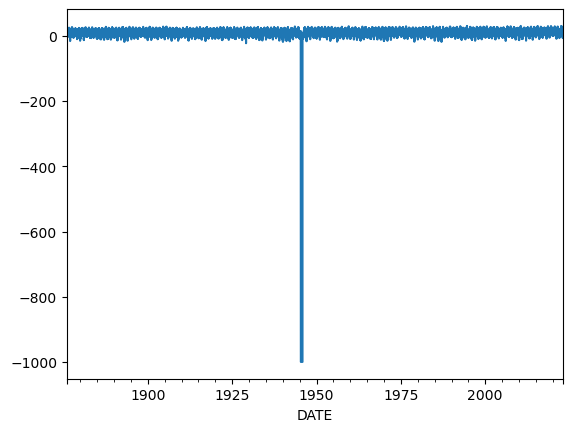

In [12]:
df.groupby('DATE')['TG'].mean().plot()

<AxesSubplot: xlabel='DATE'>

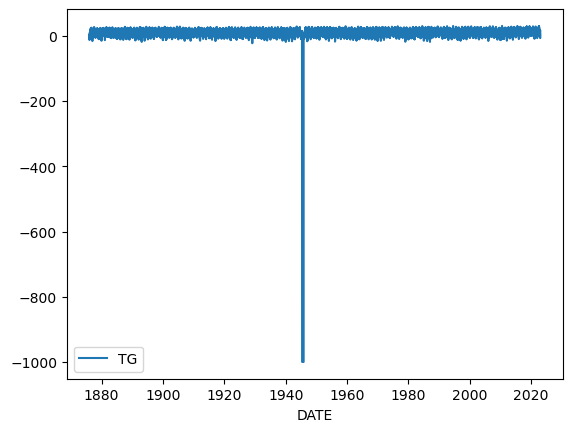

In [13]:
sns.lineplot(data = df)

<AxesSubplot: xlabel='DATE'>

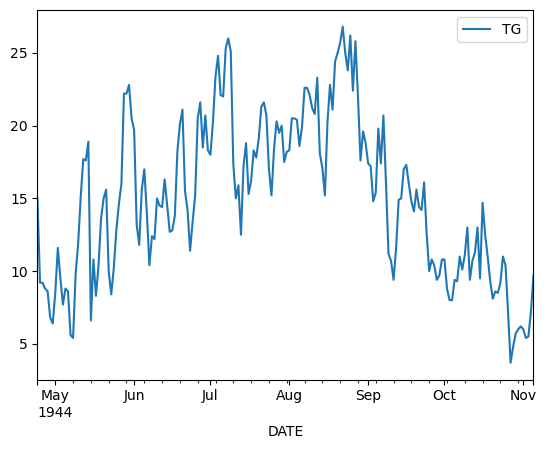

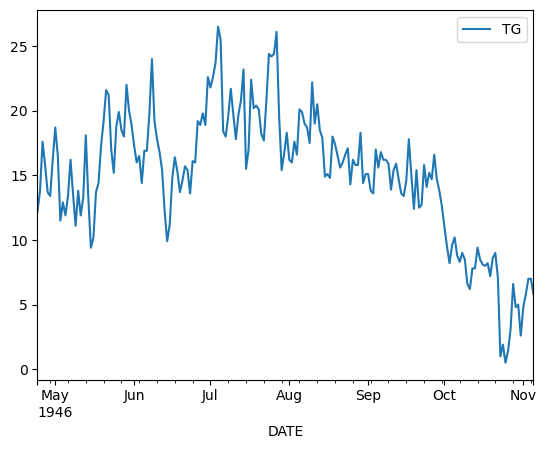

In [14]:
df.loc["24 April 1944":"5 November 1944"].plot()
df.loc["24 April 1946":"5 November 1946"].plot()

In [15]:
df.loc["24 April 1945":"5 November 1945"] = (df.loc["24 April 1944":"5 November 1944"].values + df.loc["24 April 1946":"5 November 1946"].values)/2

<AxesSubplot: xlabel='DATE'>

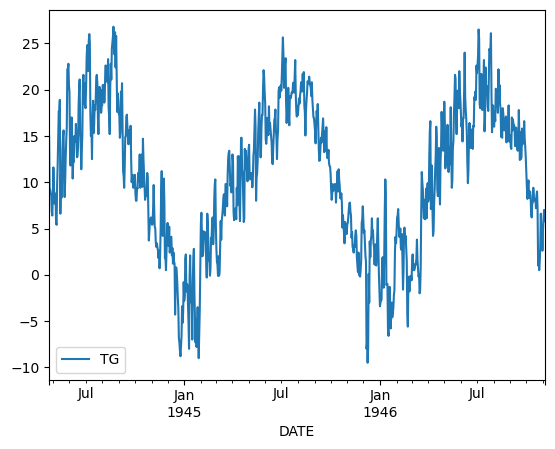

In [16]:
df.loc["24 April 1944":"5 November 1946"].plot()


In [17]:
def plot_df(df, title='Monthly TG Numbers in 1000 over Time', ylim=True):
    '''
    Custom plotting function for plotting the Tem dataset
    
    Parameters
    ----------
    df : pd.DataFrame
        The data to plot.
    title : str
        The title of the plot
    ylim : bool
        Whether to fix the minimum value of y; defalut is True
    
    Returns
    -------
    Plots the data
    '''
    df.plot()
    plt.title(title)
    plt.ylabel('# of TG in 1000')
    if ylim:
        plt.ylim(ymin=0)
    plt.show()

In [18]:
df

,TG
DATE,
1876-01-01,2.2
1876-01-02,2.5
1876-01-03,0.3
1876-01-04,-5.8
1876-01-05,-9.8
...,...
2022-12-27,4.2
2022-12-28,6.3
2022-12-29,10.0


In [19]:
list(range(len(df)))

[0,
 1,
 2,
 3,
 4,
 5,
 6,
 7,
 8,
 9,
 10,
 11,
 12,
 13,
 14,
 15,
 16,
 17,
 18,
 19,
 20,
 21,
 22,
 23,
 24,
 25,
 26,
 27,
 28,
 29,
 30,
 31,
 32,
 33,
 34,
 35,
 36,
 37,
 38,
 39,
 40,
 41,
 42,
 43,
 44,
 45,
 46,
 47,
 48,
 49,
 50,
 51,
 52,
 53,
 54,
 55,
 56,
 57,
 58,
 59,
 60,
 61,
 62,
 63,
 64,
 65,
 66,
 67,
 68,
 69,
 70,
 71,
 72,
 73,
 74,
 75,
 76,
 77,
 78,
 79,
 80,
 81,
 82,
 83,
 84,
 85,
 86,
 87,
 88,
 89,
 90,
 91,
 92,
 93,
 94,
 95,
 96,
 97,
 98,
 99,
 100,
 101,
 102,
 103,
 104,
 105,
 106,
 107,
 108,
 109,
 110,
 111,
 112,
 113,
 114,
 115,
 116,
 117,
 118,
 119,
 120,
 121,
 122,
 123,
 124,
 125,
 126,
 127,
 128,
 129,
 130,
 131,
 132,
 133,
 134,
 135,
 136,
 137,
 138,
 139,
 140,
 141,
 142,
 143,
 144,
 145,
 146,
 147,
 148,
 149,
 150,
 151,
 152,
 153,
 154,
 155,
 156,
 157,
 158,
 159,
 160,
 161,
 162,
 163,
 164,
 165,
 166,
 167,
 168,
 169,
 170,
 171,
 172,
 173,
 174,
 175,
 176,
 177,
 178,
 179,
 180,
 181,
 182,
 183,
 184,


In [20]:
# Create a monthly column for the trend
df['month'] = df.index.month
df.head()

,TG,month
DATE,,
1876-01-01,2.2,1
1876-01-02,2.5,1
1876-01-03,0.3,1
1876-01-04,-5.8,1
1876-01-05,-9.8,1


In [21]:
# Create a timestep variable
df['timestep'] = list(range(len(df)))
df.head()

,TG,month,timestep
DATE,,,
1876-01-01,2.2,1,0
1876-01-02,2.5,1,1
1876-01-03,0.3,1,2
1876-01-04,-5.8,1,3
1876-01-05,-9.8,1,4


In [22]:
df.columns

Index(['TG', 'month', 'timestep'], dtype='object')

In [23]:
# Run a Linear Regression
m = LinearRegression()
# X = df[['month']] # Gave us a stepwise function without any obvious trend over time
X = df[['timestep']]
y =df.TG
m.fit(X, y)

LinearRegression()

### Plot the trend and the original data

In [24]:
# Use the model to make a prediction
df['trend'] = m.predict(X)
df.head(15)

,TG,month,timestep,trend
DATE,,,,
1876-01-01,2.2,1,0,8.507200
1876-01-02,2.5,1,1,8.507234
1876-01-03,0.3,1,2,8.507269
1876-01-04,-5.8,1,3,8.507303
1876-01-05,-9.8,1,4,8.507338
1876-01-06,-7.7,1,5,8.507372
1876-01-07,-6.6,1,6,8.507407
1876-01-08,-8.9,1,7,8.507441
1876-01-09,-12.7,1,8,8.507476


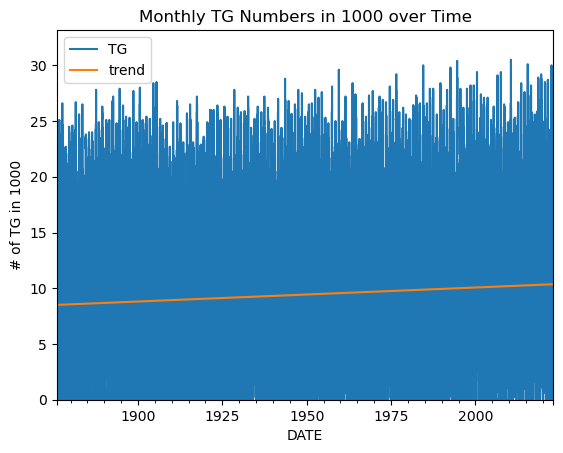

In [25]:
plot_df(df[['TG', 'trend']])

In [26]:
import plotly.express as px
px.scatter(df[['TG','trend']])

In [27]:
m.intercept_,m.coef_

(8.507199844754425, array([3.44645671e-05]))

### Model the seasonality

In [28]:
# one-hot encode the months

pd.get_dummies(df.month,prefix='month')

,month_1,month_2,month_3,month_4,month_5,month_6,month_7,month_8,month_9,month_10,month_11,month_12
DATE,,,,,,,,,,,,
1876-01-01,1,0,0,0,0,0,0,0,0,0,0,0
1876-01-02,1,0,0,0,0,0,0,0,0,0,0,0
1876-01-03,1,0,0,0,0,0,0,0,0,0,0,0
1876-01-04,1,0,0,0,0,0,0,0,0,0,0,0
1876-01-05,1,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...
2022-12-27,0,0,0,0,0,0,0,0,0,0,0,1
2022-12-28,0,0,0,0,0,0,0,0,0,0,0,1
2022-12-29,0,0,0,0,0,0,0,0,0,0,0,1


In [29]:
df

,TG,month,timestep,trend
DATE,,,,
1876-01-01,2.2,1,0,8.507200
1876-01-02,2.5,1,1,8.507234
1876-01-03,0.3,1,2,8.507269
1876-01-04,-5.8,1,3,8.507303
1876-01-05,-9.8,1,4,8.507338
...,...,...,...,...
2022-12-27,4.2,12,53686,10.357465
2022-12-28,6.3,12,53687,10.357499
2022-12-29,10.0,12,53688,10.357534


In [32]:
# One-Hot-Encoding the month
seasonal_dummies = pd.get_dummies(df.month,prefix='month')
# sklearn.preprocessing.OneHotEncoder

df = df.join(seasonal_dummies)

ValueError: columns overlap but no suffix specified: Index(['month_1', 'month_2', 'month_3', 'month_4', 'month_5', 'month_6',
       'month_7', 'month_8', 'month_9', 'month_10', 'month_11', 'month_12'],
      dtype='object')

In [33]:
df.head()

,TG,month,timestep,trend,month_1,month_2,month_3,month_4,month_5,month_6,month_7,month_8,month_9,month_10,month_11,month_12
DATE,,,,,,,,,,,,,,,,
1876-01-01,2.2,1,0,8.507200,1,0,0,0,0,0,0,0,0,0,0,0
1876-01-02,2.5,1,1,8.507234,1,0,0,0,0,0,0,0,0,0,0,0
1876-01-03,0.3,1,2,8.507269,1,0,0,0,0,0,0,0,0,0,0,0
1876-01-04,-5.8,1,3,8.507303,1,0,0,0,0,0,0,0,0,0,0,0
1876-01-05,-9.8,1,4,8.507338,1,0,0,0,0,0,0,0,0,0,0,0


In [34]:
# Define X and y
X = df.drop(columns=['TG', 'month', 'trend'])

In [35]:
X

,timestep,month_1,month_2,month_3,month_4,month_5,month_6,month_7,month_8,month_9,month_10,month_11,month_12
DATE,,,,,,,,,,,,,
1876-01-01,0,1,0,0,0,0,0,0,0,0,0,0,0
1876-01-02,1,1,0,0,0,0,0,0,0,0,0,0,0
1876-01-03,2,1,0,0,0,0,0,0,0,0,0,0,0
1876-01-04,3,1,0,0,0,0,0,0,0,0,0,0,0
1876-01-05,4,1,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-12-27,53686,0,0,0,0,0,0,0,0,0,0,0,1
2022-12-28,53687,0,0,0,0,0,0,0,0,0,0,0,1
2022-12-29,53688,0,0,0,0,0,0,0,0,0,0,0,1


In [36]:
y

DATE
1876-01-01     2.2
1876-01-02     2.5
1876-01-03     0.3
1876-01-04    -5.8
1876-01-05    -9.8
              ... 
2022-12-27     4.2
2022-12-28     6.3
2022-12-29    10.0
2022-12-30     7.6
2022-12-31    14.8
Name: TG, Length: 53691, dtype: float64

In [37]:
m.fit(X, y)

LinearRegression()

In [38]:
# Create a model with trend and seasonality
df['trend_seasonal'] = m.predict(X)
df.head()

,TG,month,timestep,trend,month_1,month_2,month_3,month_4,month_5,month_6,month_7,month_8,month_9,month_10,month_11,month_12,trend_seasonal
DATE,,,,,,,,,,,,,,,,,
1876-01-01,2.2,1,0,8.507200,1,0,0,0,0,0,0,0,0,0,0,0,-0.882471
1876-01-02,2.5,1,1,8.507234,1,0,0,0,0,0,0,0,0,0,0,0,-0.882438
1876-01-03,0.3,1,2,8.507269,1,0,0,0,0,0,0,0,0,0,0,0,-0.882404
1876-01-04,-5.8,1,3,8.507303,1,0,0,0,0,0,0,0,0,0,0,0,-0.882370
1876-01-05,-9.8,1,4,8.507338,1,0,0,0,0,0,0,0,0,0,0,0,-0.882336


### Plot the original data and the trend

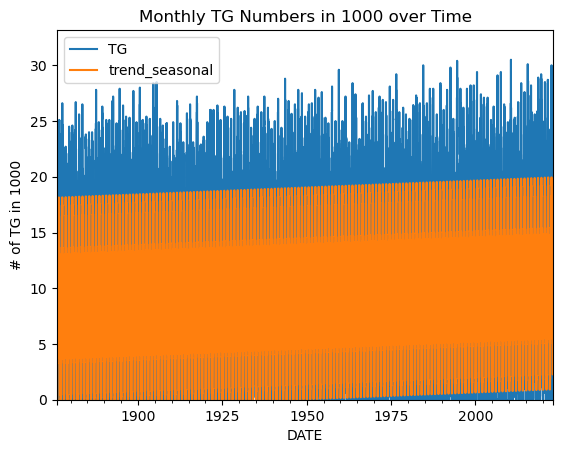

In [39]:
plot_df(df[['TG', 'trend_seasonal']])

In [40]:
px.scatter(df[['TG','trend_seasonal']])

## Extract the remainder

In [41]:
df

,TG,month,timestep,trend,month_1,month_2,month_3,month_4,month_5,month_6,month_7,month_8,month_9,month_10,month_11,month_12,trend_seasonal
DATE,,,,,,,,,,,,,,,,,
1876-01-01,2.2,1,0,8.507200,1,0,0,0,0,0,0,0,0,0,0,0,-0.882471
1876-01-02,2.5,1,1,8.507234,1,0,0,0,0,0,0,0,0,0,0,0,-0.882438
1876-01-03,0.3,1,2,8.507269,1,0,0,0,0,0,0,0,0,0,0,0,-0.882404
1876-01-04,-5.8,1,3,8.507303,1,0,0,0,0,0,0,0,0,0,0,0,-0.882370
1876-01-05,-9.8,1,4,8.507338,1,0,0,0,0,0,0,0,0,0,0,0,-0.882336
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-12-27,4.2,12,53686,10.357465,0,0,0,0,0,0,0,0,0,0,0,1,2.269263
2022-12-28,6.3,12,53687,10.357499,0,0,0,0,0,0,0,0,0,0,0,1,2.269297
2022-12-29,10.0,12,53688,10.357534,0,0,0,0,0,0,0,0,0,0,0,1,2.269330


In [42]:
df['remainder'] = df.TG - df.trend_seasonal

In [44]:
df.head(5)

,TG,month,timestep,trend,month_1,month_2,month_3,month_4,month_5,month_6,month_7,month_8,month_9,month_10,month_11,month_12,trend_seasonal,remainder
DATE,,,,,,,,,,,,,,,,,,
1876-01-01,2.2,1,0,8.507200,1,0,0,0,0,0,0,0,0,0,0,0,-0.882471,3.082471
1876-01-02,2.5,1,1,8.507234,1,0,0,0,0,0,0,0,0,0,0,0,-0.882438,3.382438
1876-01-03,0.3,1,2,8.507269,1,0,0,0,0,0,0,0,0,0,0,0,-0.882404,1.182404
1876-01-04,-5.8,1,3,8.507303,1,0,0,0,0,0,0,0,0,0,0,0,-0.882370,-4.917630
1876-01-05,-9.8,1,4,8.507338,1,0,0,0,0,0,0,0,0,0,0,0,-0.882336,-8.917664


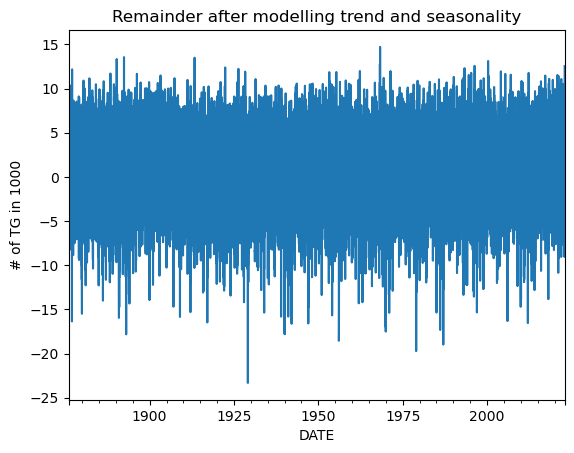

In [45]:
plot_df(df['remainder'], title='Remainder after modelling trend and seasonality', ylim=False)

In [48]:
px.scatter(df[['remainder']])

In [49]:
df['remainder'].mean(), df.remainder.std()

(9.824866868344758e-16, 3.924679386567844)

In [52]:
import numpy as np
#random_array = np.random.normal(loc=0, scale=10, size=132)
#plot_df(df[['remainder', 'random']], title='Compare remainder to randomness', ylim=False)

## Save the remainder

In [54]:
df['remainder'].to_csv('df_remainder.csv')

In [31]:
y = df['count']
X = df.drop('count', axis=1)

KeyError: 'count'

How would you check for unexpected values?

## 3) Train-Test-Split

Take the final year into test data.

In [ ]:
df_train = df[:-365]

df_test = df[-365:]

## 4) Visualize the Data

In [ ]:
df.groupby('year')['monthly_anomaly'].mean().plot()

## 5) Feature Engineer

What kind of feature engineering you did before when you were dealing with temporal data that has the monthly information or so on? Which part of it might be useful this week? This can still be done before or after the train/test split (but make sure you use the same methods on both).

In [ ]:
df_train_fe = feature_engineer(df_train)

In [ ]:
# Now assign X and y
y_train = df_train_fe.copy().iloc[:,0]
X_train = df_train_fe.copy().iloc[:,1:]

## 6) Train a model

In [ ]:
m = LinearRegression()
m.fit(X_train, y_train)

**You will see other models this week!**

## 7) Cross-Validate and Optimize Hyperparameters

## 8) Test

In [ ]:
df_test_fe = feature_engineer(df_test)

y_test = df_test_fe.copy().iloc[:,0]
X_test = df_test_fe.copy().iloc[:,1:]

In [ ]:
y_pred = m.predict(X_test)
m.score(X_test, y_test)